![](image.png)

## Contents
- <a href='#1'>1. Load Python libraries and importing the data</a>  
- <a href='#2'>2. Import Data from GCS</a> 
- <a href='#3'>3. Feature Engineering</a>
    - <a href='#3.1'>3.1. Missing Values</a> 
    - <a href='#3.2'>3.2. Change to Datetime</a> 
    - <a href='#3.2'>3.3. Profit check</a> 
    - <a href='#3.2'>3.4. Distance Calculation</a> 
    - <a href='#3.3'>3.5. Normal Distribution</a>
    - <a href='#3.3'>3.6. Log Transformation</a>    
- <a href='#4'>4. Save the Feature Artifacts</a>
- <a href='#5'>5. Geo Graphical plots</a>


## 1. Load Python libraries and importing the data

In [1]:
import plotly
import warnings
import numpy as np 
import pandas as pd
import seaborn as sns
import cufflinks as cf
from scipy import stats
from datetime import datetime
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from scipy.special import boxcox
import plotly.offline as offline
from scipy.stats import norm, skew
import plotly.figure_factory as ff
from sklearn.preprocessing import PowerTransformer
from plotly.graph_objs import Scatter, Figure, Layout
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


init_notebook_mode(connected=True)
%matplotlib inline
warnings.simplefilter("ignore")
cf.set_config_file(offline=True)

In [2]:
#!pip install -r requirements.txt
#!jupyter labextension install jupyterlab-plotly 

Building jupyterlab assets (build:prod:minimize)


##  2. Import Data from GCS

Upload the CSV to your respective GCS Bucket provide the name Below

In [2]:
fare_details=pd.read_csv("gs://<BUCKET>/faredetails.csv")
fare_details.head()

,driver_id,pickup_datetime,passenger_count,fare_amount
0,610685,2009-06-15 17:26:21 UTC,1,4.5
1,825735,2010-01-05 16:52:16 UTC,1,16.9
2,428317,2011-08-18 00:35:00 UTC,2,5.7
3,356886,2012-04-21 04:30:42 UTC,1,7.7
4,603801,2010-03-09 07:51:00 UTC,1,5.3


In [3]:
trip_details=pd.read_csv("gs://<BUCKET>/tripdetails.csv")
trip_details.head()

,driver_id,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,610685,2009-06-15 17:26:21.0000001,2009-06-15 17:26:21 UTC,-73.844311,40.721319,-73.841610,40.712278
1,825735,2010-01-05 16:52:16.0000002,2010-01-05 16:52:16 UTC,-74.016048,40.711303,-73.979268,40.782004
2,428317,2011-08-18 00:35:00.00000049,2011-08-18 00:35:00 UTC,-73.982738,40.761270,-73.991242,40.750562
3,356886,2012-04-21 04:30:42.0000001,2012-04-21 04:30:42 UTC,-73.987130,40.733143,-73.991567,40.758092
4,603801,2010-03-09 07:51:00.000000135,2010-03-09 07:51:00 UTC,-73.968095,40.768008,-73.956655,40.783762


## 3 Feature Engineering

### 3.1 Missing Values

In [4]:
fare_details.isna().sum()

driver_id          0
pickup_datetime    0
passenger_count    0
fare_amount        0
dtype: int64

In [5]:
trip_details.isna().sum()

driver_id            0
key                  0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
dtype: int64

In [6]:
## Drop Ambiguous  Data
fare_details=fare_details[fare_details['fare_amount']>0]

### 3.2 Change to Datetime

In [7]:
fare_details.dtypes

driver_id            int64
pickup_datetime     object
passenger_count      int64
fare_amount        float64
dtype: object

In [8]:
trip_details.dtypes

driver_id              int64
key                   object
pickup_datetime       object
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
dtype: object

In [9]:
def change_datetime(df,col):
    df[col]=pd.to_datetime(df[col])
    return df

In [10]:
fare_details=change_datetime(fare_details,'pickup_datetime')
trip_details=change_datetime(trip_details,'key')
trip_details=change_datetime(trip_details,'pickup_datetime')

### 3.3 Profit check

In [11]:
profit=0
loss=0
target=[]
#np.exp(fare_details.fare_amount)
for i in fare_details.fare_amount:
    if i > 8:
        profit=profit+1
        target.append(1)
    else:
        loss=loss+1
        target.append(0)
        
fare_details['target']=target

In [12]:
fare_details.target.value_counts()

1    15996
0    13998
Name: target, dtype: int64

### 3.4 Distance Calculation

In [13]:
trip_details['longitude_distance'] = abs(trip_details['pickup_longitude'] - trip_details['dropoff_longitude'])
trip_details['latitude_distance'] = abs(trip_details['pickup_latitude'] - trip_details['dropoff_latitude'])
trip_details['distance_travelled'] = (trip_details['longitude_distance'] ** 2 + trip_details['latitude_distance'] ** 2) ** .5

In [14]:
trip_details.head()

,driver_id,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,longitude_distance,latitude_distance,distance_travelled
0,610685,2009-06-15 17:26:21.000000100,2009-06-15 17:26:21+00:00,-73.844311,40.721319,-73.841610,40.712278,0.002701,0.009041,0.009436
1,825735,2010-01-05 16:52:16.000000200,2010-01-05 16:52:16+00:00,-74.016048,40.711303,-73.979268,40.782004,0.036780,0.070701,0.079696
2,428317,2011-08-18 00:35:00.000000490,2011-08-18 00:35:00+00:00,-73.982738,40.761270,-73.991242,40.750562,0.008504,0.010708,0.013674
3,356886,2012-04-21 04:30:42.000000100,2012-04-21 04:30:42+00:00,-73.987130,40.733143,-73.991567,40.758092,0.004437,0.024949,0.025340
4,603801,2010-03-09 07:51:00.000000135,2010-03-09 07:51:00+00:00,-73.968095,40.768008,-73.956655,40.783762,0.011440,0.015754,0.019470


### 3.5 Normal Distribution

In [15]:
class distribution_skew_check:
    
    def __init__(self,col,df,size_bin):
        self.col=col
        self.data=df
        self.size_bin=size_bin
        
    def plot_distribution(self) :  
        temp = self.data[self.col]
        hist_data = [temp]
        group_labels = [self.col]
        colors = ['#ff7f0e']
        fig = ff.create_distplot(hist_data, group_labels, colors = colors, show_hist = True, bin_size = self.size_bin, curve_type='kde')
        fig['layout'].update(title = f"Distribution Plots with Skewness {stats.skew(self.data[self.col])}")
        fig.show()
    
    def qq_plots(self):
        qq = stats.probplot(np.array(self.data[self.col]), dist='lognorm', sparams=(1))
        x = np.array([qq[0][0][0], qq[0][0][-1]])
        fig = go.Figure()
        fig.add_scatter(x=qq[0][0], y=qq[0][1], mode='markers')
        fig.add_scatter(x=x, y=qq[1][1] + qq[1][0]*x, mode='lines')
        fig.layout.update(showlegend=False)
        fig.update_layout(height=500, width=1000,title_text="Multiple Subplots with Titles")
        fig.show()

    
    

In [16]:
(mu, sigma) = norm.fit(fare_details['fare_amount'])
print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))


 mu = 11.36 and sigma = 9.65



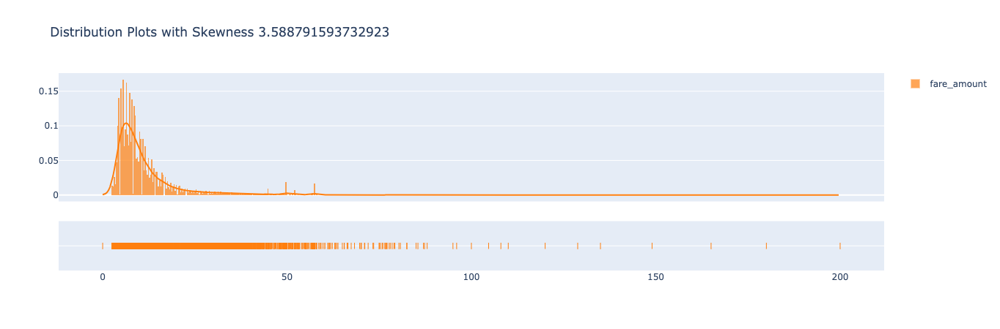

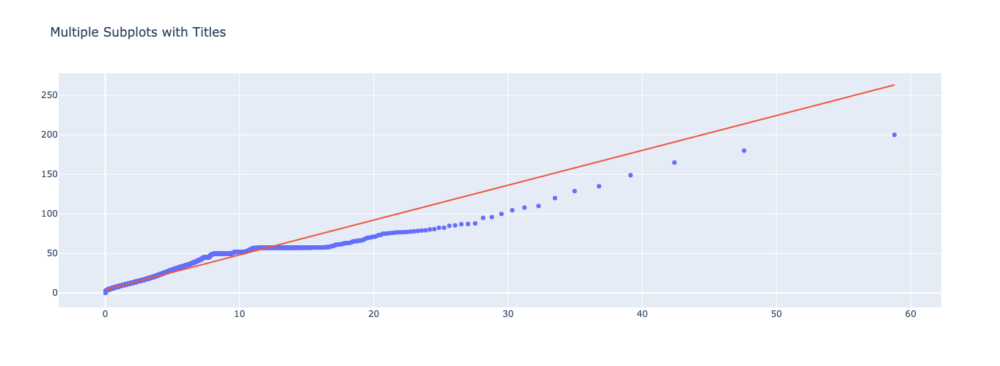

In [17]:
visualize_check=distribution_skew_check('fare_amount',fare_details,0.3)
visualize_check.plot_distribution()
visualize_check.qq_plots()

### 3.6 Log Transformation

In [24]:
#We use the numpy fuction log1p which  applies log(1+x) to all elements of the column
fare_details["fare_amount"] = np.log1p(fare_details["fare_amount"]) 

In [18]:
pt = PowerTransformer(method='yeo-johnson')
data = pt.fit_transform(fare_details["fare_amount"].values.reshape(-1, 1))
fare=pd.DataFrame(data,columns=['fare_amount'])
fare_details["fare_amount"]=fare['fare_amount']

In [20]:
fare_details.fillna(fare_details.mean(), inplace=True)

In [21]:
(mu, sigma) = norm.fit(fare_details['fare_amount'])
print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))


 mu = 0.00 and sigma = 1.00



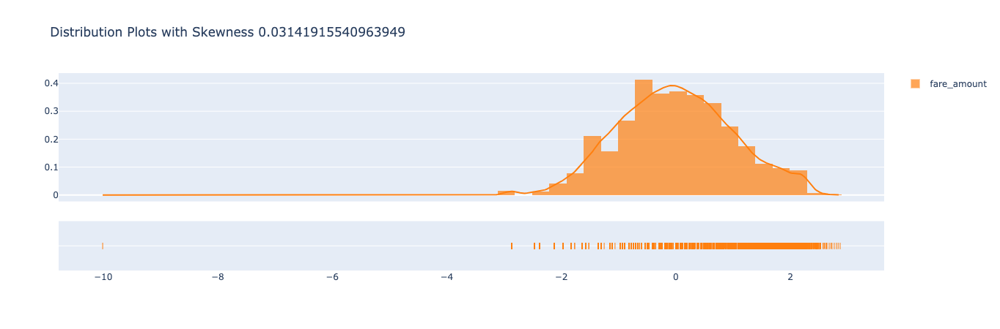

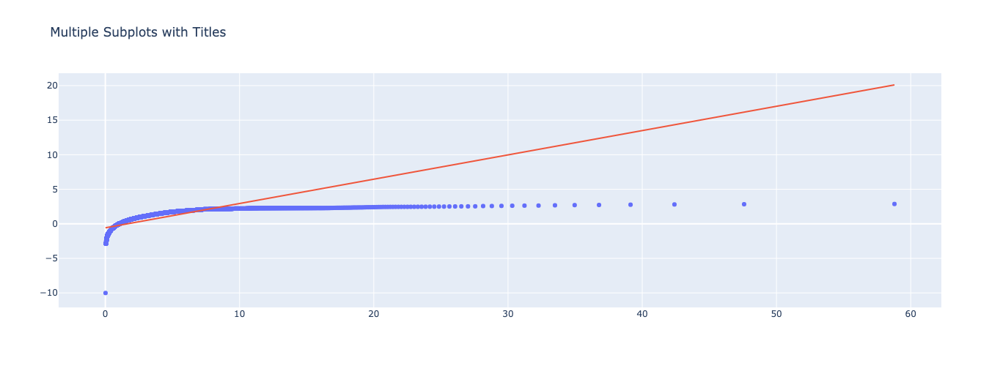

In [22]:
visualize_check=distribution_skew_check('fare_amount',fare_details,0.3)
visualize_check.plot_distribution()
visualize_check.qq_plots()

## 4 Save the Feature Artifacts 

In [23]:
def created_time(trip_details,fare_details):
    time = pd.to_datetime(datetime.now())
    trip_details['created'] = time
    fare_details['created'] = time
    return trip_details,fare_details


In [24]:
trip_details,fare_details=created_time(trip_details,fare_details)

In [25]:
trip_details.dtypes

driver_id                           int64
key                        datetime64[ns]
pickup_datetime       datetime64[ns, UTC]
pickup_longitude                  float64
pickup_latitude                   float64
dropoff_longitude                 float64
dropoff_latitude                  float64
longitude_distance                float64
latitude_distance                 float64
distance_travelled                float64
created                    datetime64[ns]
dtype: object

In [26]:
fare_details.dtypes

driver_id                        int64
pickup_datetime    datetime64[ns, UTC]
passenger_count                  int64
fare_amount                    float64
target                           int64
created                 datetime64[ns]
dtype: object

In [27]:
trip_details.to_csv('tripdetails.csv',index=False)
fare_details.to_csv('faredetails.csv',index=False)

## 5 Geo Graphical plots

> Get a token from https://account.mapbox.com/

In [28]:
class geo_plots:
    
    def __init__(self,df,col_key,token,plot):
        
        if plot.lower()=="pickup":
            self.data=df
            self.key=col_key
            self.token=token
            self.title="Pick up Locations in NewYork"
            self.lat='pickup_latitude'
            self.long='pickup_longitude'
                 
        else:
            self.data=df
            self.key=col_key
            self.token=token
            self.title="Drop off locations in Newyork"
            self.lat='dropoff_latitude'
            self.long='dropoff_longitude'
            

    def geo_plots(self):
        
        data = [go.Scattermapbox(
            lat= self.data[self.lat] ,
            lon= self.data[self.long],
            customdata = self.data[self.key],
            mode='markers',
            marker=dict(
                size= 4,
                color = 'gold',
                opacity = .8,
            ),
          )]
        layout = go.Layout(autosize=False,
                           mapbox= dict(accesstoken=self.token,
                                        bearing=10,
                                        pitch=60,
                                        zoom=13,
                                        center= dict(
                                                 lat=40.721319,
                                                 lon=-73.987130),
                                                 style= "mapbox://styles/shaz13/cjiog1iqa1vkd2soeu5eocy4i"),
                            width=900,
                            height=600, title = self.title)
        fig = dict(data=data, layout=layout)
        iplot(fig)
        

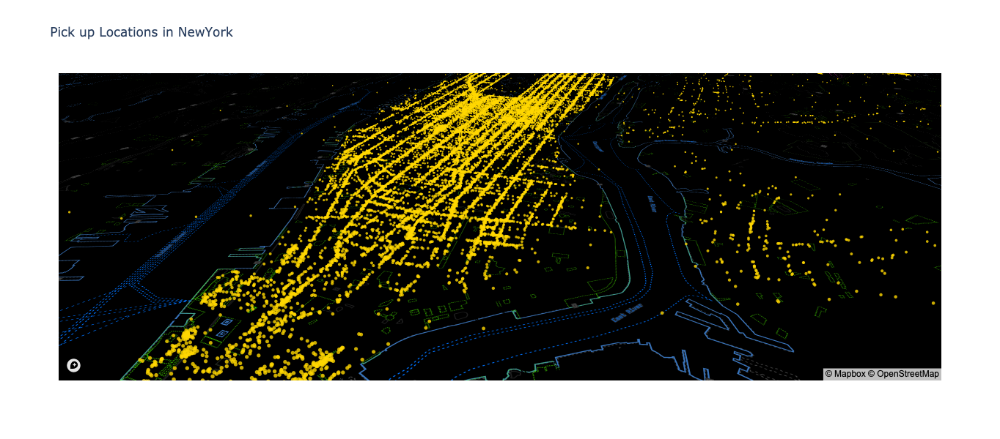

In [29]:
token='pk.eyJ1IjoiYW5pcnVkZGhhbWFwIiwiYSI6ImNrb3F4bm5pdDBodW4yd2xjdnV4d2E5c2sifQ.yhSIxfzfbyCJltlJLOtKPw'
pick_up=geo_plots(trip_details,'key',token,'pickup')
pick_up.geo_plots()

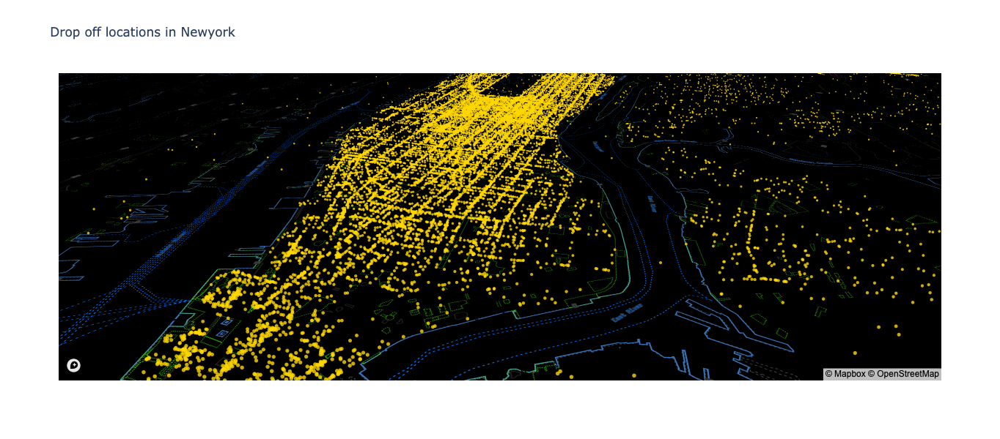

In [30]:
pick_up=geo_plots(trip_details,'key',token,'drop')
pick_up.geo_plots()